In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv
import glob

In [2]:
lower_range1 = np.array([122,87,189])
upper_range1 = np.array([143,107,269])
lower_range2 = np.array([124,79,190])
upper_range2 = np.array([144,99,270])
lower_range3 = np.array([130,48,154])
upper_range3 = np.array([150,68,234])
lower_range4 = np.array([122,102,192])
upper_range4 = np.array([142,122,272])
lower_range5 = np.array([124,73,166])
upper_range5 = np.array([144,93,246])
lower_range6 = np.array([125,75,176])
upper_range6 = np.array([145,95,256])
lower_range7 = np.array([126,52,170])
upper_range7 = np.array([146,72,250])
lower_range8 = np.array([120,130,178])
upper_range8 = np.array([140,150,258])
lower_range9 = np.array([115,17,175])
upper_range9 = np.array([135,37,255])
lower_range10 = np.array([104,28,161])
upper_range10 = np.array([124,48,241])
lower_range11 = np.array([109,64,157])
upper_range11 = np.array([129,84,237])
lower_range12 = np.array([119,151,196])
upper_range12 = np.array([139,171,276])
lower_range13 = np.array([129,40,157])
upper_range13 = np.array([149,60,237])

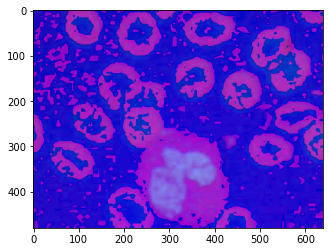

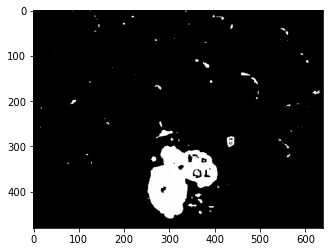

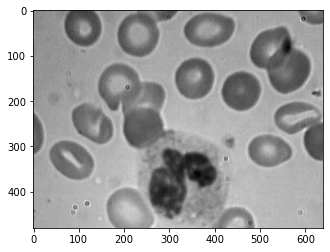

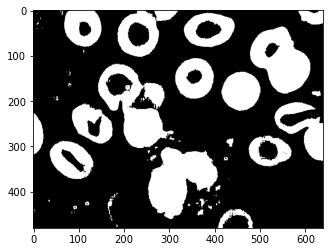

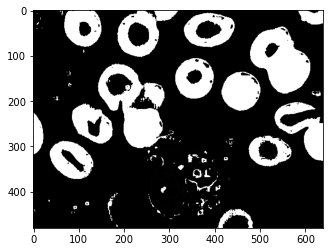

...

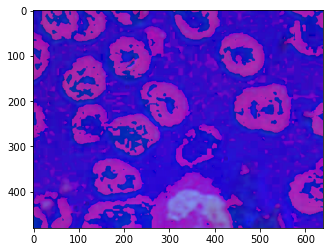

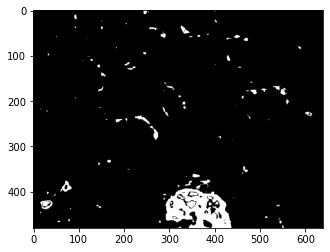

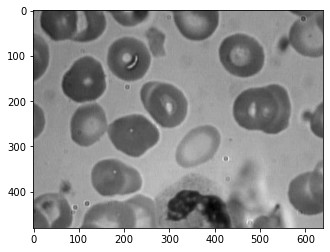

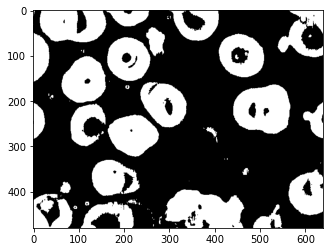

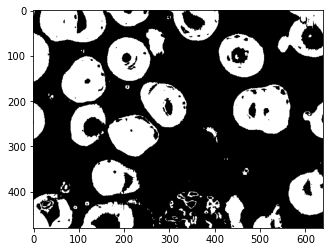

In [3]:
### first step is  to remove white blood cells from dataset
for i in range(1,51):
    
    file = "BloodImage_" + format(i) +".jpg"
    img  = cv.imread("Red_Blood_Cell/"+file)
    hsv = cv.cvtColor(img, cv.COLOR_BGR2HSV)
    plt.imshow(hsv,cmap="gray")
    plt.show()
    mask1 = cv.inRange(hsv, lower_range1, upper_range1)
    mask2 = cv.inRange(hsv, lower_range2, upper_range2)
    mask3 = cv.inRange(hsv, lower_range3, upper_range3)
    mask4 = cv.inRange(hsv, lower_range4, upper_range4)
    mask5 = cv.inRange(hsv, lower_range5, upper_range5)
    mask6 = cv.inRange(hsv, lower_range6, upper_range6)
    mask7 = cv.inRange(hsv, lower_range7, upper_range7)
    mask8 = cv.inRange(hsv, lower_range8, upper_range8)
    mask9 = cv.inRange(hsv, lower_range9, upper_range9)
    mask10 = cv.inRange(hsv, lower_range10, upper_range10)
    mask11 = cv.inRange(hsv, lower_range11, upper_range11)
    mask12 = cv.inRange(hsv, lower_range12, upper_range12)
    mask13 = cv.inRange(hsv, lower_range13, upper_range13)
    mask=mask1+mask2+mask3+mask4+mask5+mask6+mask7+mask8+mask9+mask10+mask11+mask12+mask13  
    plt.imshow(mask,cmap="gray")
    plt.show()
    #convrert original image to gray
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    plt.imshow(gray,cmap="gray")
    plt.show()
    #thresholding
    c, thresh = cv.threshold(gray,0,255,cv.THRESH_BINARY_INV+cv.THRESH_OTSU)
    plt.imshow(thresh, cmap="gray")
    plt.show()
    
    #remove mask from gray
    
    rbc = thresh - mask
    rbc[rbc < 0] = 0
   
    plt.imshow(rbc,cmap="gray")
    plt.show()
    
    cv.imwrite("masked_data/"+file,rbc)
    
    
    plt.close()

In [4]:
###applying Gaussian Bluring,Median filtering,equalizeHist and save all respected data in separate folders
Image_blueM=[]
Image_blueG=[]
Image_equalizeHist=[]
for img in glob.glob("masked_data/*.jpg"):
    n= cv.imread(img,0)
    blurM = cv.medianBlur(n, 5)
    Image_blueM.append(blurM)
    blurG = cv.GaussianBlur(n, (9, 9), 0)
    Image_blueG.append(blurG)
    #src = cv.cvtColor(n, cv.COLOR_BGR2GRAY)
    dst = cv.equalizeHist(n)
    Image_equalizeHist.append(dst)
count_blueM=1
for k in Image_blueM:
    cv.imwrite("Images_Median/img_blueM"+str(count_blueM)+".jpg",k) 
    count_blueM+=1
print("Total No of Images_blueM",len(Image_blueM))
count_blueG=1
for k in Image_blueG:
    cv.imwrite("Images_Gaussian/img_blueG"+str(count_blueG)+".jpg",k) 
    count_blueG+=1
print("Total No of Images_blueG",len(Image_blueG))
count_equalizeHist=1
for k in Image_equalizeHist:
    cv.imwrite("EqualizeHist/img_EqualizeHist"+str(count_equalizeHist)+".jpg",k) 
    count_equalizeHist+=1
print("Total No of EqualizeHist",len(Image_equalizeHist))

Total No of Images_blueM 50
Total No of Images_blueG 50
Total No of EqualizeHist 50


In [5]:
CLAHE_Normalized_Image = []
for img in glob.glob("masked_data/*.jpg"):
    n= cv.imread(img)
    src = cv.cvtColor(n, cv.COLOR_BGR2GRAY)
    clahe = cv.createCLAHE(clipLimit = 2.0, tileGridSize=(8, 8))
    claheNorm = clahe.apply(src)
    #Adaptive_Histogram_Equalization.append(claheNorm)
    CLAHE_Normalized_Image.append(claheNorm)
count_Clahe_NI=1
for k in CLAHE_Normalized_Image:
    cv.imwrite("Adaptive_Histogram_Equalization/CLAHE_Normalized_Image"+str(count_Clahe_NI)+".jpg",k) 
    count_Clahe_NI+=1
print("Total No of Adaptive_Histogram_Equalization:",len(CLAHE_Normalized_Image))

Total No of Adaptive_Histogram_Equalization: 50


In [6]:
# contrast stretching
# Function to map each intensity level to output intensity level.
def pixelVal(pix, r1, s1, r2, s2):
    if (0 <= pix and pix <= r1):
        return (s1 / r1) * pix
    elif (r1 < pix and pix <= r2):
        return ((s2 - s1) / (r2 - r1)) * (pix - r1) + s1
    else:
        return ((255 - s2) / (255 - r2)) * (pix - r2) + s2
 
    # Define parameters.
r1 = 70
s1 = 0
r2 = 200
s2 = 255
# Vectorize the function to apply it to each value in the Numpy array.
pixelVal_vec = np.vectorize(pixelVal)

In [7]:
cv_img = []
count=1
for img in glob.glob("Images_Median/*.jpg"):
    n= cv.imread(img)   
    src = cv.cvtColor(n, cv.COLOR_BGR2GRAY)
    contrast_stretched_gray = pixelVal_vec(src, r1, s1, r2, s2)
    cv_img.append(contrast_stretched_gray)
print(len(cv_img))
for k in cv_img:
    cv.imwrite("contrast_stretched_gray/Contrast_Stretched_Image"+str(count)+".jpg",k) 
    count+=1

50


In [8]:
# edge detection using canny edge detector
cv_img2 = []
count=1
for img in glob.glob("contrast_stretched_gray/*.jpg"):
    n= cv.imread(img)
   
    src = cv.cvtColor(n, cv.COLOR_BGR2GRAY)
    edge = cv.Canny(src, 17,60)
    cv_img2.append(edge)
print(len(cv_img2))
for k in cv_img2:    
    cv.imwrite("Canny_Edge_Detection_on_contrast_stretched_gray/canny_on_contrast_stretched_gray"+str(count)+".JPEG",k) 
    count+=1

50


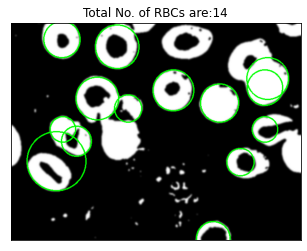

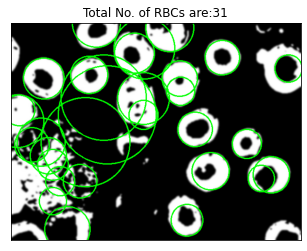

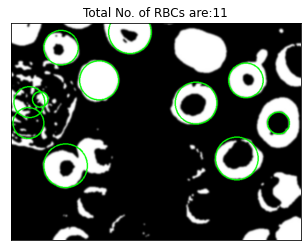

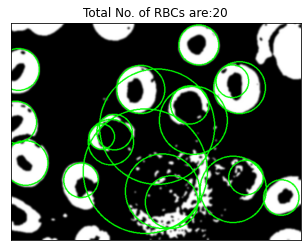

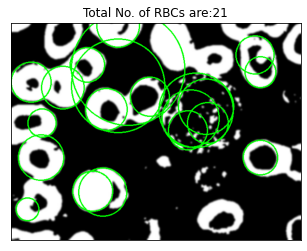

...

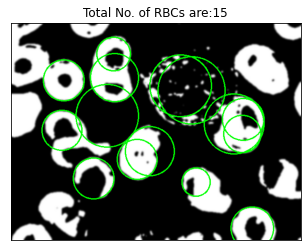

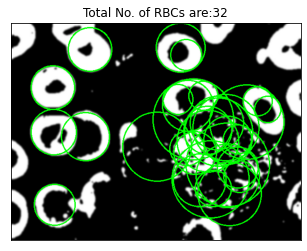

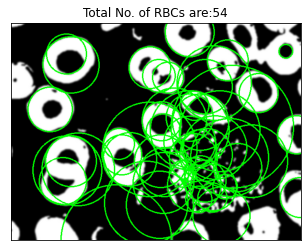

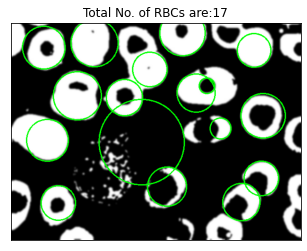

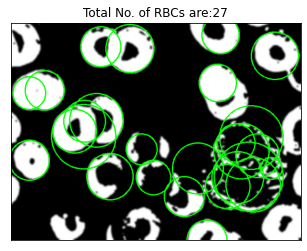

In [22]:
import glob
import cv2 as cv
from matplotlib import pyplot as plt
import numpy as np
count=0
cv_img = []
for img in glob.glob("contrast_stretched_gray/*.jpg"):
    img= cv.imread(img) 
    img = cv.GaussianBlur(img, (9, 9), 0)
    img_copy = img.copy()
    # Convert to greyscale
    img_gray = cv.cvtColor(img_copy, cv.COLOR_BGR2GRAY)
    # Apply Hough transform to greyscale image
    circles = cv.HoughCircles(img_gray, 
                          cv.HOUGH_GRADIENT, 
                          1, 20, param1 = 60, param2 = 40, 
                          minRadius = 0, maxRadius = 0)
    circles = np.uint16(np.around(circles))
   
    for i in circles[0,:]:
    
        # draw the outer circle
        # cv2.circle(image, center_coordinates, radius, color, thickness)
        cv.circle(img, (i[0], i[1]), i[2], (0, 255, 0), 2)

        # draw the center of the circle
        #cv.circle(img, (i[0], i[1]), 2, (0, 0, 255), 3)
    circle_count = circles.shape[1]
    # Display Image
    plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
    plt.title('Total No. of RBCs are:'+str(circle_count))
    plt.xticks([])
    plt.yticks([])
    plt.savefig("By_gobal_hough_parameters/hough_circles_images"+str(count)+".JPEG", bbox_inches='tight')
    plt.show()
    count=count+1

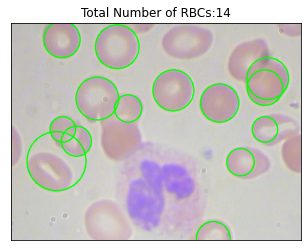

In [9]:
img=cv.imread("contrast_stretched_gray/Contrast_Stretched_Image1.jpg")
real=cv.imread("Red_Blood_Cell/BloodImage_1.jpg")
img = cv.GaussianBlur(img, (9, 9), 0)
img_copy = img.copy()
# Convert to greyscale
img_gray = cv.cvtColor(img_copy, cv.COLOR_BGR2GRAY)
# Apply Hough transform to greyscale image
circles = cv.HoughCircles(img_gray, 
                         cv.HOUGH_GRADIENT, 
                          1, 20, param1 = 60, param2 = 40, 
                          minRadius = 0, maxRadius = 0)
circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    cv.circle(real, (i[0], i[1]), i[2], (0, 255, 0), 2)
circle_count = circles.shape[1]
    # Display Image
plt.imshow(cv.cvtColor(real, cv.COLOR_BGR2RGB))
plt.title('Total Number of RBCs:'+str(circle_count))
plt.xticks([])
plt.yticks([])
plt.savefig("Hough_Transform/circle_detection_Real_img1.JPG", bbox_inches='tight')
plt.show()

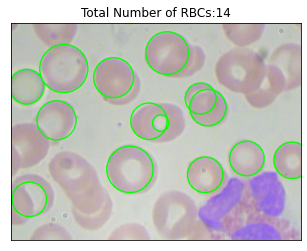

In [10]:
img=cv.imread("contrast_stretched_gray/Contrast_Stretched_Image3.jpg")
real=cv.imread("Red_Blood_Cell/BloodImage_19.jpg")
img = cv.GaussianBlur(img, (9, 9), 0)
img_copy = img.copy()
# Convert to greyscale
img_gray = cv.cvtColor(img_copy, cv.COLOR_BGR2GRAY)
# Apply Hough transform to greyscale image
circles = cv.HoughCircles(img_gray, 
                         cv.HOUGH_GRADIENT, 
                          1, 16, param1 = 70, param2 = 45, 
                          minRadius = 0, maxRadius = 0)
circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    cv.circle(real, (i[0], i[1]), i[2], (0, 255, 0), 2)
circle_count = circles.shape[1]
    # Display Image
plt.imshow(cv.cvtColor(real, cv.COLOR_BGR2RGB))
plt.title('Total Number of RBCs:'+str(circle_count))
plt.xticks([])
plt.yticks([])
plt.savefig("Hough_Transform/circle_detection_Real_img2.JPG", bbox_inches='tight')
plt.show()

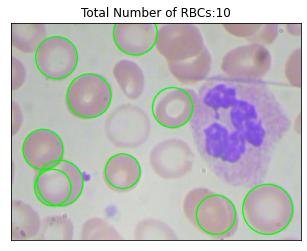

In [11]:
img=cv.imread("contrast_stretched_gray/Contrast_Stretched_Image5.jpg")
real=cv.imread("Red_Blood_Cell/BloodImage_20.jpg")
img = cv.GaussianBlur(img, (9, 9), 0)
img_copy = img.copy()
# Convert to greyscale
img_gray = cv.cvtColor(img_copy, cv.COLOR_BGR2GRAY)
# Apply Hough transform to greyscale image
circles = cv.HoughCircles(img_gray, 
                         cv.HOUGH_GRADIENT, 
                          1, 16, param1 = 60, param2 = 44, 
                          minRadius = 0, maxRadius = 0)
circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    cv.circle(real, (i[0], i[1]), i[2], (0, 255, 0), 2)
circle_count = circles.shape[1]
plt.imshow(cv.cvtColor(real, cv.COLOR_BGR2RGB))
plt.title('Total Number of RBCs:'+str(circle_count))
plt.xticks([])
plt.yticks([])
plt.savefig("Hough_Transform/circle_detection_Real_img3.JPG", bbox_inches='tight')
plt.show()

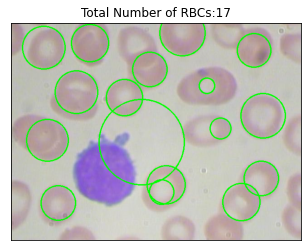

In [12]:
img=cv.imread("contrast_stretched_gray/Contrast_Stretched_Image8.jpg")
real=cv.imread("Red_Blood_Cell/BloodImage_23.jpg")
img = cv.GaussianBlur(img, (9, 9), 0)
img_copy = img.copy()
# Convert to greyscale
img_gray = cv.cvtColor(img_copy, cv.COLOR_BGR2GRAY)
# Apply Hough transform to greyscale image
circles = cv.HoughCircles(img_gray, 
                         cv.HOUGH_GRADIENT, 
                          1, 20, param1 = 60, param2 = 41, 
                          minRadius = 0, maxRadius = 0)
circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    cv.circle(real, (i[0], i[1]), i[2], (0, 255, 0), 2)
circle_count = circles.shape[1]
    # Display Image
plt.imshow(cv.cvtColor(real, cv.COLOR_BGR2RGB))
plt.title('Total Number of RBCs:'+str(circle_count))
plt.xticks([])
plt.yticks([])
plt.savefig("Hough_Transform/circle_detection_Real_img4.JPG", bbox_inches='tight')
plt.show()

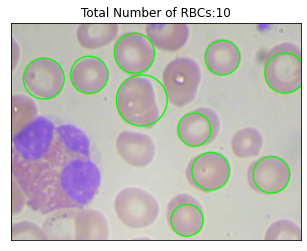

In [13]:
img=cv.imread("contrast_stretched_gray/Contrast_Stretched_Image10.jpg")
real=cv.imread("Red_Blood_Cell/BloodImage_25.jpg")
img = cv.GaussianBlur(img, (9, 9), 0)
img_copy = img.copy()
# Convert to greyscale
img_gray = cv.cvtColor(img_copy, cv.COLOR_BGR2GRAY)
# Apply Hough transform to greyscale image
circles = cv.HoughCircles(img_gray, 
                         cv.HOUGH_GRADIENT, 
                          1, 20, param1 = 60, param2 = 49, 
                          minRadius = 0, maxRadius = 0)
circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    cv.circle(real, (i[0], i[1]), i[2], (0, 255, 0), 2)
circle_count = circles.shape[1]
    # Display Image
plt.imshow(cv.cvtColor(real, cv.COLOR_BGR2RGB))
plt.title('Total Number of RBCs:'+str(circle_count))
plt.xticks([])
plt.yticks([])
plt.savefig("Hough_Transform/circle_detection_Real_img5.JPG", bbox_inches='tight')
plt.show()

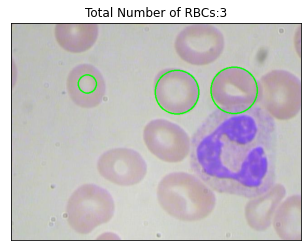

In [15]:
img=cv.imread("contrast_stretched_gray/Contrast_Stretched_Image22.jpg")
real=cv.imread("Red_Blood_Cell/BloodImage_35.jpg")
img = cv.GaussianBlur(img, (9, 9), 0)
img_copy = img.copy()
# Convert to greyscale
img_gray = cv.cvtColor(img_copy, cv.COLOR_BGR2GRAY)
# Apply Hough transform to greyscale image
circles = cv.HoughCircles(img_gray, 
                         cv.HOUGH_GRADIENT, 
                          1, 20, param1 = 70, param2 = 48, 
                          minRadius = 0, maxRadius = 0)
circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    cv.circle(real, (i[0], i[1]), i[2], (0, 255, 0), 2)
circle_count = circles.shape[1]
    # Display Image
plt.imshow(cv.cvtColor(real, cv.COLOR_BGR2RGB))
plt.title('Total Number of RBCs:'+str(circle_count))
plt.xticks([])
plt.yticks([])
plt.savefig("Hough_Transform/circle_detection_Real_img7.JPG", bbox_inches='tight')
plt.show()

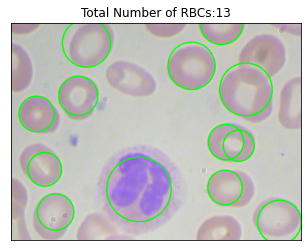

In [16]:
img=cv.imread("contrast_stretched_gray/Contrast_Stretched_Image23.jpg")
real=cv.imread("Red_Blood_Cell/BloodImage_11.jpg")
img = cv.GaussianBlur(img, (9, 9), 0)
img_copy = img.copy()
# Convert to greyscale
img_gray = cv.cvtColor(img_copy, cv.COLOR_BGR2GRAY)
# Apply Hough transform to greyscale image
circles = cv.HoughCircles(img_gray, 
                         cv.HOUGH_GRADIENT, 
                          1, 25, param1 = 70, param2 = 48, 
                          minRadius = 0, maxRadius = 0)
circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    cv.circle(real, (i[0], i[1]), i[2], (0, 255, 0), 2)
circle_count = circles.shape[1]
    # Display Image
    # Display Image
plt.imshow(cv.cvtColor(real, cv.COLOR_BGR2RGB))
plt.title('Total Number of RBCs:'+str(circle_count))
plt.xticks([])
plt.yticks([])
plt.savefig("Hough_Transform/circle_detection_Real_img8.JPG", bbox_inches='tight')
plt.show()

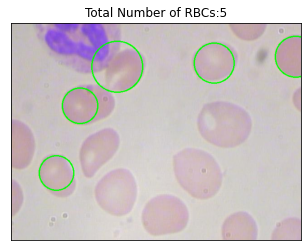

In [17]:
img=cv.imread("contrast_stretched_gray/Contrast_Stretched_Image27.jpg")
real=cv.imread("Red_Blood_Cell/BloodImage_39.jpg")
img = cv.GaussianBlur(img, (9, 9), 0)
img_copy = img.copy()
# Convert to greyscale
img_gray = cv.cvtColor(img_copy, cv.COLOR_BGR2GRAY)
# Apply Hough transform to greyscale image
circles = cv.HoughCircles(img_gray, 
                         cv.HOUGH_GRADIENT, 
                          1, 20, param1 = 70, param2 = 35, 
                          minRadius = 0, maxRadius = 0)
circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    cv.circle(real, (i[0], i[1]), i[2], (0, 255, 0), 2)
circle_count = circles.shape[1]
    # Display Image
plt.imshow(cv.cvtColor(real, cv.COLOR_BGR2RGB))
plt.title('Total Number of RBCs:'+str(circle_count))
plt.xticks([])
plt.yticks([])
plt.savefig("Hough_Transform/circle_detection_Real_img10.JPG", bbox_inches='tight')
plt.show()

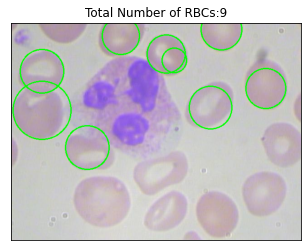

In [18]:
img=cv.imread("contrast_stretched_gray/Contrast_Stretched_Image31.jpg")
real=cv.imread("Red_Blood_Cell/BloodImage_42.jpg")
img = cv.GaussianBlur(img, (9, 9), 0)
img_copy = img.copy()
# Convert to greyscale
img_gray = cv.cvtColor(img_copy, cv.COLOR_BGR2GRAY)
# Apply Hough transform to greyscale image
circles = cv.HoughCircles(img_gray, 
                         cv.HOUGH_GRADIENT, 
                          1, 20, param1 = 70, param2 = 38, 
                          minRadius = 0, maxRadius = 0)
circles = np.uint16(np.around(circles))
for i in circles[0,:]:
    cv.circle(real, (i[0], i[1]), i[2], (0, 255, 0), 2)
circle_count = circles.shape[1]
    # Display Image
plt.imshow(cv.cvtColor(real, cv.COLOR_BGR2RGB))
plt.title('Total Number of RBCs:'+str(circle_count))
plt.xticks([])
plt.yticks([])
plt.savefig("Hough_Transform/circle_detection_Real_img11.JPG", bbox_inches='tight')
plt.show()